In [2]:
from MagicCube import MagicCube
import time
import matplotlib.pyplot as plt

In [ ]:
def steepest_ascent_hill_climbing(cube, maxIter=50):
    iteration = 0
    history = [] # Setiap ditemukan objective function baru yang lebih baik, maka akan dievaluasi
    timeStart = time.time()

    # Menyimpan nilai objective function awal
    current_objfunc = cube.objective_function()
    history.append(current_objfunc)

    # SteepestAscent HillClimb, terdapat 3 kondisi
    # 1. Jika iterasi sudah mencapai maksimal, mengeluarkan kondisi current state
    while iteration < maxIter:
        nextStates = cube.next_states()
        bestStates = None
        best_objfunc = current_objfunc

        # Mencari state terbaik dari neighbor
        for next_state in nextStates:
            neighbor_objfunc = next_state.objective_function()
            print(f"Iterasi {iteration + 1}: Current: {current_objfunc}, Neighbor: {neighbor_objfunc}")

            if neighbor_objfunc < best_objfunc:
                bestStates = next_state
                best_objfunc = neighbor_objfunc

        # Jika menemukan state yang lebih baik, perbarui state
        if bestStates:
            cube = bestStates
            current_objfunc = best_objfunc
            history.append(current_objfunc)

        # 2. Jika tidak menemukan state yang lebih baik, 
        # keluar dari loop search dan keluarkan hasil current state
        else:
            print("Tidak ada solusi yang lebih baik, berhenti pada local maximum")
            break

        iteration += 1

        # 3. Jika solusi valid ditemukan, berhenti
        if cube.is_valid_magic_cube():
            print(f"Solusi ditemukan setelah {iteration} iterasi.")
            break

    duration = time.time() - timeStart
    print(f"Final State: {current_objfunc}")
    return cube, history, iteration, duration

In [4]:
# Visualisasi dari kode
def visualize_experiment(initial_cube, final_cube, history):
    print("Initial State:")
    initial_cube.visualize()

    print("Final State:")
    final_cube.visualize()

    plt.plot(range(len(history)), history, color='blue')
    plt.title('Objective Function terhadap Banyak Iterasi')
    plt.xlabel('Iterasi')
    plt.ylabel('Objective Function (f(x))')
    plt.grid(True)
    plt.show()

Iterasi 1: Current: 8857, Neighbor: 8933
Iterasi 1: Current: 8857, Neighbor: 8883
Iterasi 1: Current: 8857, Neighbor: 8811
Iterasi 1: Current: 8857, Neighbor: 8857
Iterasi 1: Current: 8857, Neighbor: 8971
Iterasi 1: Current: 8857, Neighbor: 8886
Iterasi 1: Current: 8857, Neighbor: 8783
Iterasi 1: Current: 8857, Neighbor: 8849
Iterasi 1: Current: 8857, Neighbor: 8775
Iterasi 1: Current: 8857, Neighbor: 8825
Iterasi 1: Current: 8857, Neighbor: 8813
Iterasi 1: Current: 8857, Neighbor: 8857
Iterasi 1: Current: 8857, Neighbor: 8913
Iterasi 1: Current: 8857, Neighbor: 8959
Iterasi 1: Current: 8857, Neighbor: 8973
Iterasi 1: Current: 8857, Neighbor: 8904
Iterasi 1: Current: 8857, Neighbor: 8893
Iterasi 1: Current: 8857, Neighbor: 8900
Iterasi 1: Current: 8857, Neighbor: 8983
Iterasi 1: Current: 8857, Neighbor: 8857
Iterasi 1: Current: 8857, Neighbor: 8947
Iterasi 1: Current: 8857, Neighbor: 8773
Iterasi 1: Current: 8857, Neighbor: 8795
Iterasi 1: Current: 8857, Neighbor: 8857
Iterasi 1: Curre

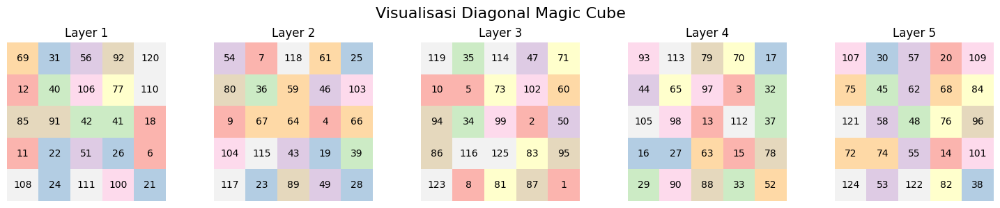

Final State:


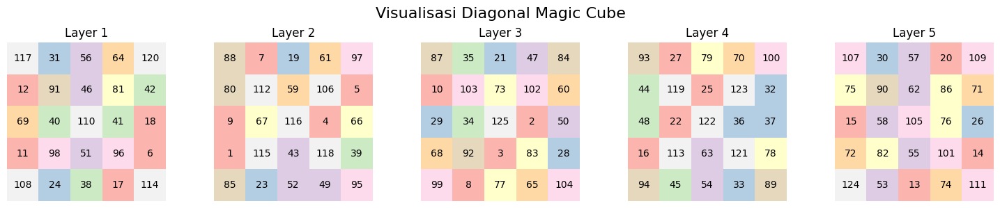

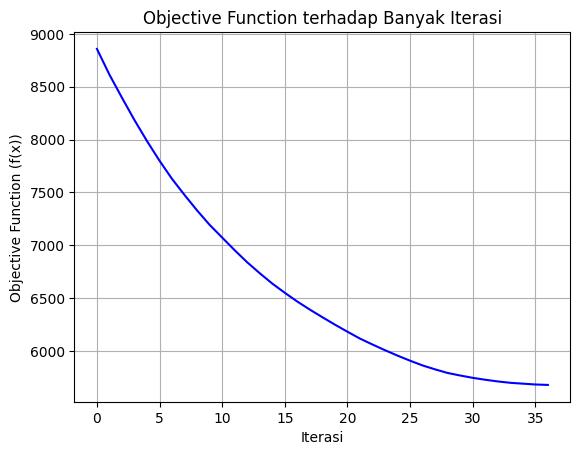

In [5]:
# Menjalankan kode
if __name__ == "__main__":
    initial_cube = MagicCube(n=5)

    final_cube, history, iterations, duration = steepest_ascent_hill_climbing(initial_cube)

    print(f"Total Iterasi: {iterations}")
    print(f"Durasi: {duration:.2f} detik")
    visualize_experiment(initial_cube, final_cube, history)